#Import Dependencies

In [1]:
!pip install flow_vis

In [2]:
!pip install package_name

  Preparing metadata (setup.py) ... done
  Created wheel for package_name: filename=package_name-0.1-py3-none-any.whl size=1232 sha256=95bd7a62ee4cd292a18623d4a28bc03cceea029ca4ea6f4248781adb20791a90
  Stored in directory: /root/.cache/pip/wheels/a3/36/c4/98d928f30290fb88555f848f73093f02b67c984a45c56c3e97
Successfully built package_name


In [3]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 645.2/645.2 kB 6.6 MB/s eta 0:00:00


In [4]:

import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import pandas as pd
import cv2

from google.colab import drive
from sklearn.model_selection import train_test_split
from pkg_resources import parse_version

import datetime
from google.colab.patches import cv2_imshow
from statistics import mean

# Maybe use flowpy instead which can read/write png and flo files in KITTI and Middleburry format respectively.
import matplotlib.patches as patches
import matplotlib
import matplotlib.pyplot as plt

# Tensorflow ≥2.0 is required
import tensorflow as tf
import tensorflow_datasets as tfds


# Python ≥3.5 is required
import sys
assert sys.version_info >= (3,5)

# flow_vis library implements Middlebury flow vector coloring
import flow_vis
import yaml

from PIL import Image
from ultralytics import YOLO
import subprocess
from IPython.display import HTML
from base64 import b64encode

In [5]:
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
dummy = tf.constant( 32 )
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


#Helper Functions

In [7]:
def reset_seed(seed=42):
    np.random.seed(seed)
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
if 'google.colab' in str(get_ipython()):
  print('Running on CoLab')
  from google.colab import drive

  drive.mount('/content/drive')

  #PROJECT_ROOT_DIR = "/content/drive/MyDrive/Colab Notebooks/CV/data/tensorflow_data"
  PROJECT_ROOT_DIR = "/content/drive/MyDrive/CV"
else:
  print('Not running on CoLab')
  PROJECT_ROOT_DIR = os.getcwd()

NB_ID = "project"


Running on CoLab
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [8]:
def plot_image(image):
    plt.imshow(image, cmap="gray", interpolation="nearest")
    plt.axis("off")

###Preprocessing

 `process_data`function takes three inputs: `train_data` (containing video information), `class_name` (a string representing the class), and `video_num` (an integer representing the video number).

The function processes each frame in the video, extracts bounding box information for instances of a specific category (category 14 in this case), and creates a dictionary (`dic`) with keys 'image', 'target', and 'image_path'.

For each frame, it extracts the image, relevant target bounding box coordinates, and constructs an image path. The resulting dictionary contains lists of images, corresponding target bounding box information, and image paths.

The function returns this dictionary as its output. Overall, it facilitates the extraction and organization of data from video frames for further processing or analysis.

In [9]:
IDcounts = {int(i): 0 for i in range(17)}

def process_data(train_data, class_name, video_num):
    dic = {'image': [], 'target': [], 'image_path': []}
    num_frames = int(train_data['metadata']['num_frames'])
    resolution = [train_data['metadata']['height'], train_data['metadata']['width']]
    folder_name = class_name + "_video_" + str(video_num)

    for i in range(num_frames):
        target = []
        category = []
        image = train_data['video'][i, :, :, :]
        segmentation = train_data['segmentations'][i, :, :, :].numpy()
        for id in range(train_data['instances']['bbox_frames'].shape[0]):
            if i in train_data['instances']['bbox_frames'][id]:
                t = find_index(train_data['instances']['bbox_frames'][id], i)
                item = train_data['instances']['bboxes'][id, t, :]

                y_min = int(item[0] * float(resolution[0]))
                x_min = int(item[1] * float(resolution[1]))
                y_max = int(item[2] * float(resolution[0]))
                x_max = int(item[3] * float(resolution[1]))
                category = train_data["instances"]["category"][id].numpy()
                # Increment the count for the category
                IDcounts[int(category)] += 1

                target.append([y_min, x_min, y_max, x_max, category])

        image_path = f"{folder_name}_image_{i}"
        dic['image'].append(image.numpy())
        dic['target'].append(target)
        dic['image_path'].append(image_path)

    return dic


`find_index` function searches for the index of a specified element (`id`) within a given list or array (`input`). It iterates through the elements, returning the index of the first occurrence of the specified element. If the element is not found, the function returns `None`. The `break` statement after the `return` is unnecessary as `return` exits the function immediately.

In [10]:
def find_index(input, id):
    for i in range(len(input)):
        if input[i] == id:
            return i
            break

###Normalization

`normalize_bbox` function takes a bounding box (`box`) and the shape of the corresponding image (`image_shape`) as input. It normalizes the bounding box coordinates by calculating the center coordinates (`x_center` and `y_center`), width (`width`), and height (`height`) relative to the dimensions of the image. The function then returns these normalized values along with the category information from the original bounding box (`box`).

In [11]:
# Function to normalize the bounding boxes
def normalize_bbox(box, image_shape):
    y_min, x_min, y_max, x_max = box[0:4]
    x_center = (x_min + x_max) / (2 * image_shape[1])
    y_center = (y_min + y_max) / (2 * image_shape[0])
    width = (x_max - x_min) / image_shape[1]
    height = (y_max - y_min) / image_shape[0]
    return x_center, y_center, width, height, box[4]

###Show Multiple Object

`plot_images_with_Multiple_bbox(dataframe)`funtion creates a visual representation of images with multiple bounding boxes. It uses a Pandas DataFrame containing image and bounding box information, arranging the images in a grid of subplots. Bounding boxes are drawn on each image, displayed in a red rectangle, providing a clear visualization of object localization. The function adjusts the layout to accommodate varying numbers of images and removes unnecessary subplots, resulting in an organized and informative visual summary.

In [12]:
def plot_images_with_Multiple_bbox(dataframe):
    num_images = len(dataframe)
    rows = (num_images + 3) // 4  # Calculate the number of rows for subplots
    fig, axes = plt.subplots(rows, 4, figsize=(12, 3 * rows))
    axes = axes.ravel()

    for idx, (_, row) in enumerate(dataframe.iterrows()):
        image = np.array(row['image'])
        targets = row['target']

        ax = axes[idx]
        ax.imshow(image)

        for target in targets:
            y, x, height, width, obj_id = target  # Extract object ID
            rect = patches.Rectangle((x, y), width - x, height - y, linewidth=1, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

            # Display object ID above the bounding box
            ax.text(x, y - 5, str(obj_id), color='r', fontsize=12, fontweight='bold')

        ax.axis('off')

    # Remove any empty subplots
    for i in range(num_images, rows * 4):
        fig.delaxes(axes[i])

    plt.tight_layout()
    plt.show()


###Filter data by Object ID

`filter_lists_by_objectTrackID` function processes a DataFrame containing image-related information. It filters rows based on whether the 'target' column in each row includes lists with a specified `objectTrackID` as their last element. The function creates a new DataFrame with the filtered rows, excluding those that do not meet the criteria. The resulting DataFrame, named `new_df`, contains only rows where the 'target' column has lists ending with the specified `objectTrackID`.

In [13]:
def filter_lists_by_objectTrackID(df, objectTrackID):
    new_data = {'image': [], 'target': [], 'image_path': [], 'VideoID': [], 'ImageID': [], 'Class': []}

    for _, row in df.iterrows():
        targets = row['target']
        filtered_lists = []

        # Iterate over each list in the 'target' column
        for target_list in targets:
            # Check if the last number in the list matches the specified 'objectTrackID'
            if target_list[-1] == objectTrackID:
                filtered_lists.append(target_list)


        # Check if the filtered lists are not empty before adding the row to the new DataFrame
        if filtered_lists:
            new_data['image'].append(row['image'])
            new_data['target'].append(filtered_lists)
            new_data['image_path'].append(row['image_path'])
            new_data['VideoID'].append(row['VideoID'])
            new_data['ImageID'].append(row['ImageID'])
            new_data['Class'].append(row['Class'])

    # Create a new DataFrame with the filtered 'target' column
    new_df = pd.DataFrame(new_data)

    return new_df

#Data Preprocessing

The provided code loads image data from different classes ('linear_movement_rotate', 'rotation_rotate', 'fixed_random_rotate') using TensorFlow Datasets (tfds). It then processes each video in the dataset using the `process_data` function, extracting relevant information such as images, targets, video IDs, and image IDs. The processed data is stored in a Pandas DataFrame named `df`, which consolidates information from all classes. The DataFrame includes columns for images, targets, image paths, video IDs, image IDs, and class labels.

In [14]:
data_path = os.path.join(PROJECT_ROOT_DIR)
class_names = ["linear_movement_rotate", "rotation_rotate", "fixed_random_rotate"]
class_data_frames = []

for class_name in class_names:
    data_frame = {'image': [], 'target': [], 'image_path': [], 'VideoID': [], 'ImageID': [], 'Class': []}
    class_data = tfds.load(f'elg7186_projectdata/{class_name}', data_dir=data_path)

    for video_num, video_data in enumerate(class_data['train']):
        dic = process_data(video_data, class_name, video_num)
        video_id = video_num  # Extracting only the number from the video ID
        for i, img_path in enumerate(dic['image_path']):
            image_id = i  # Extracting only the number from the image ID
            data_frame['image'].append(dic['image'][i])
            data_frame['target'].append(dic['target'][i])
            data_frame['image_path'].append(img_path)
            data_frame['VideoID'].append(video_id)
            data_frame['ImageID'].append(image_id)
            data_frame['Class'].append(class_name)

    df_class_data = pd.DataFrame(data_frame)
    class_data_frames.append(df_class_data)

# Combine data frames of all classes
df = pd.concat(class_data_frames, ignore_index=True)
df

,image,target,image_path,VideoID,ImageID,Class
0,"[[[97, 88, 91], [97, 87, 91], [96, 86, 90], [9...","[[105, 37, 255, 174, 16], [167, 190, 256, 252,...",linear_movement_rotate_video_0_image_0,0,0,linear_movement_rotate
1,"[[[98, 89, 94], [95, 87, 91], [95, 86, 90], [9...","[[108, 36, 250, 166, 16], [162, 178, 256, 256,...",linear_movement_rotate_video_0_image_1,0,1,linear_movement_rotate
2,"[[[96, 87, 92], [97, 88, 94], [97, 89, 95], [9...","[[110, 37, 245, 156, 16], [161, 169, 256, 256,...",linear_movement_rotate_video_0_image_2,0,2,linear_movement_rotate
3,"[[[95, 86, 92], [95, 86, 92], [98, 89, 96], [9...","[[112, 42, 241, 151, 16], [163, 163, 256, 256,...",linear_movement_rotate_video_0_image_3,0,3,linear_movement_rotate
4,"[[[98, 89, 95], [97, 88, 95], [96, 87, 94], [9...","[[112, 49, 246, 159, 16], [167, 162, 256, 256,...",linear_movement_rotate_video_0_image_4,0,4,linear_movement_rotate
...,...,...,...,...,...,...
2155,"[[[192, 80, 47], [196, 80, 47], [200, 82, 47],...","[[66, 125, 149, 184, 16]]",fixed_random_rotate_video_29_image_19,29,19,fixed_random_rotate
2156,"[[[192, 81, 47], [196, 80, 47], [200, 82, 47],...","[[66, 125, 147, 184, 16]]",fixed_random_rotate_video_29_image_20,29,20,fixed_random_rotate
2157,"[[[192, 81, 47], [196, 80, 47], [200, 82, 47],...","[[67, 126, 145, 183, 16]]",fixed_random_rotate_video_29_image_21,29,21,fixed_random_rotate
2158,"[[[192, 81, 47], [196, 80, 47], [200, 82, 47],...","[[69, 125, 146, 185, 16]]",fixed_random_rotate_video_29_image_22,29,22,fixed_random_rotate


##Show Images

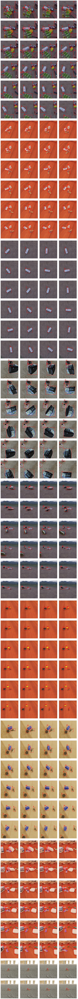

In [15]:
plot_images_with_Multiple_bbox(df[0:200])

##Object Counts

In [16]:
# Sort the dictionary based on values in descending order
sorted_IDcounts = dict(sorted(IDcounts.items(), key=lambda item: item[1], reverse=True))

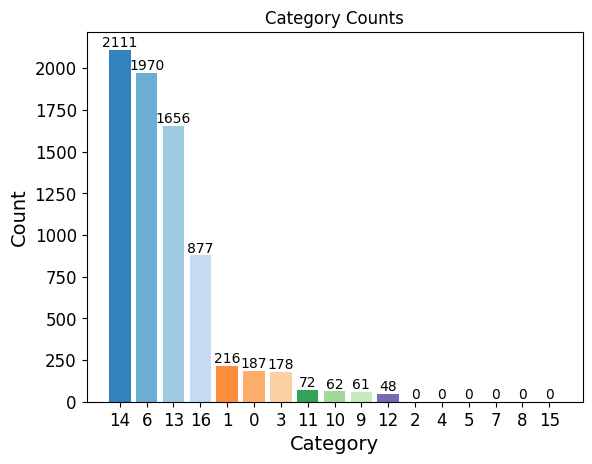

In [17]:
# Convert keys to strings
IDcounts_str_keys = {str(key): value for key, value in IDcounts.items()}
sorted_IDcounts = dict(sorted(IDcounts_str_keys.items(), key=lambda item: item[1], reverse=True))

categories = list(sorted_IDcounts.keys())
counts = list(sorted_IDcounts.values())

colors = plt.cm.tab20c(np.linspace(0, 1, len(categories)))  # Use 'YlGnBu' colormap here
bars = plt.bar(categories, counts, color=colors)

plt.xlabel('Category')
plt.ylabel('Count')
plt.title('Category Counts')

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval, round(yval), ha='center', va='bottom')

plt.show()


#Select Object

In [18]:
objectTrackID=14

In [ ]:
new_df = filter_lists_by_objectTrackID(df, objectTrackID)
new_df

In [ ]:
plot_images_with_Multiple_bbox(new_df[0:10])

##Apply Normalization

In [ ]:
# Applying the function to the 'target' column
image_shape = (256, 256)  # Example image shape
new_df['normalize_target'] = new_df['target'].apply(lambda x: [normalize_bbox(box, image_shape) for box in x])
new_df

#Spliting Data (Train,Valdiution,Test)

###Counts of this Object in each video in the 3 classes

The code generates a DataFrame grouped_counts_df from a grouped Series grouped_counts containing counts per unique combinations of 'Class' and 'VideoID', applying a blue color gradient to visually represent the counts using the background_gradient method in Pandas' Styler.

In [ ]:
grouped_counts = new_df.groupby(['Class', 'VideoID']).size()

# Convert the Series to a DataFrame
grouped_counts_df = grouped_counts.reset_index(name='Count')
grouped_counts_df.style.background_gradient(cmap='Blues')


###Split Data

The code performs grouping and counting of unique 'Class' and 'VideoID' combinations in the DataFrame `new_df`. It subsequently splits the data into training and validation sets, maintaining the 70-30 ratio for each 'Class' and 'VideoID' group without shuffling. Finally, it stores the segmented sets in `X_train` and `X_valid` DataFrames for further analysis or modeling purposes.

In [ ]:
# Convert the Series to a DataFrame
grouped_counts_df = grouped_counts.reset_index(name='Count')

# Initialize X_train_df and X_valid_df DataFrames
train_df = pd.DataFrame(columns=new_df.columns)
valid_df = pd.DataFrame(columns=new_df.columns)

# Iterating through each group
for idx, row in grouped_counts_df.iterrows():
    class_val, video_id, count = row['Class'], row['VideoID'], row['Count']

    # Get the group based on Class and VideoID
    group = new_df[(new_df['Class'] == class_val) & (new_df['VideoID'] == video_id)]

    # Splitting the group into train and validation sets (70% train, 30% validation) without shuffling
    train_set, valid_set = train_test_split(group, train_size=0.7, shuffle=False, random_state=42)

    # Appending to X_train_df and X_valid_df
    train_df = pd.concat([train_df, train_set])
    valid_df = pd.concat([valid_df, valid_set])

# Resetting index for X_train and X_valid
train_df.reset_index(drop=True, inplace=True)
valid_df.reset_index(drop=True, inplace=True)

###Spliting according to video and its frames count in each class

In [ ]:
grouped_counts_X_train = train_df.groupby(['Class', 'VideoID']).size().reset_index(name='Count')
grouped_counts_X_valid = valid_df.groupby(['Class', 'VideoID']).size().reset_index(name='Count')

grouped_counts_df_all = grouped_counts_df.merge(grouped_counts_X_train.groupby(['Class', 'VideoID'])['Count'].last().reset_index(),
                                            on=['Class', 'VideoID'], how='left', suffixes=('', '_train'))

grouped_counts_df_all = grouped_counts_df_all.merge(grouped_counts_X_valid.groupby(['Class', 'VideoID'])['Count'].last().reset_index(),
                                            on=['Class', 'VideoID'], how='left', suffixes=('', '_valid'))

grouped_counts_df_all.style.background_gradient(cmap='Blues')

In [ ]:
# Assuming 'train_data' and 'valid_data' are your DataFrames

# Selecting all features except the last one for X_train and X_valid
X_train = train_df[["image","image_path","VideoID","ImageID","Class","normalize_target"]]  # Exclude the last column
X_valid = valid_df[["image","image_path","VideoID","ImageID","Class","normalize_target"]]   # Exclude the last column
y_train = train_df['target']
y_valid = valid_df['target']

# Display shapes of X_train and X_valid
print("X_train shape:", X_train.shape)
print("X_valid shape:", X_valid.shape)


#Create Folders to Train Yolo Model

The provided code iterates through both training and validation datasets (`X_train` and `X_valid`).
For each dataset:
1. It saves images from the 'image_path' column as JPG files in the specified image folder.
2. Additionally, it writes normalized target coordinates as lines in text files in the designated text folder.
3. This process follows the condition checking for `objectTrackID` before writing coordinates to text files.
4. The code effectively prepares image and target coordinate data for training and validation purposes by storing them in a format suitable for machine learning tasks.

##Train

In [ ]:
image_folder = "/content/drive/MyDrive/CV/data/images/train"
txt_folder = "/content/drive/MyDrive/CV/data/labels/train"

os.makedirs(image_folder, exist_ok=True)
os.makedirs(txt_folder, exist_ok=True)
for index, row in X_train.iterrows():
    image_path = row["image_path"]
    image_data = np.array(row["image"], dtype=np.uint8)
    normalize_target = row["normalize_target"]

    # Save image as JPG in the "images" folder
    image = Image.fromarray(image_data)
    image.save(os.path.join(image_folder, f"{image_path}.jpg"))

    # Save normalize_target as TXT in the "txt" folder
    txt_file_path = os.path.join(txt_folder, f"{image_path}.txt")
    with open(txt_file_path, "w") as file:
        for coordinates in normalize_target:
          if(coordinates[-1]==objectTrackID):
            file.write(f"{int(0)} {coordinates[0]} {coordinates[1]} {coordinates[2]} {coordinates[3] }\n")


##Valid

In [ ]:
image_folder = "/content/drive/MyDrive/CV/data/images/valid"
txt_folder = "/content/drive/MyDrive/CV/data/labels/valid"

os.makedirs(image_folder, exist_ok=True)
os.makedirs(txt_folder, exist_ok=True)
for index, row in X_valid.iterrows():
    image_path = row["image_path"]
    image_data = np.array(row["image"], dtype=np.uint8)
    normalize_target = row["normalize_target"]

    # Save image as JPG in the "images" folder
    image = Image.fromarray(image_data)
    image.save(os.path.join(image_folder, f"{image_path}.jpg"))

    # Save normalize_target as TXT in the "txt" folder
    txt_file_path = os.path.join(txt_folder, f"{image_path}.txt")
    with open(txt_file_path, "w") as file:
        for coordinates in normalize_target:
          if(coordinates[-1]==objectTrackID):
            file.write(f"{int(0)} {coordinates[0]} {coordinates[1]} {coordinates[2]} {coordinates[3] }\n")
